# <h1><center><font size='7'>Anything vs Leaves</font></center></h1>

***I created the layers myself in this code instead of using pretrained model. After training the model, I achieved a model that distinguish anything from a leaf with nearly %96 accuracy.***

In [1]:
import tensorflow as tf

In [2]:
# load the dataset
data = tf.keras.utils.image_dataset_from_directory(r"C:\Users\Safak\OneDrive\Masaüstü\anything_vs_leaves")

Found 13167 files belonging to 2 classes.


In [3]:
# get the class names
class_names = data.class_names

# print the class names
print(class_names)

['DATASET_everything', 'DATASET_leaf']


In [4]:
# iterate over the dataset to enumarate the images and labels
data_iterator = data.as_numpy_iterator()

In [5]:
# fetching the first batch
batch = data_iterator.next()
# extracting the images and labels from the batch
images, labels = batch
# number of images in the batch
num_images = images.shape[0]
print("Number of images in the batch:", num_images)

In [6]:
from matplotlib import pyplot as plt

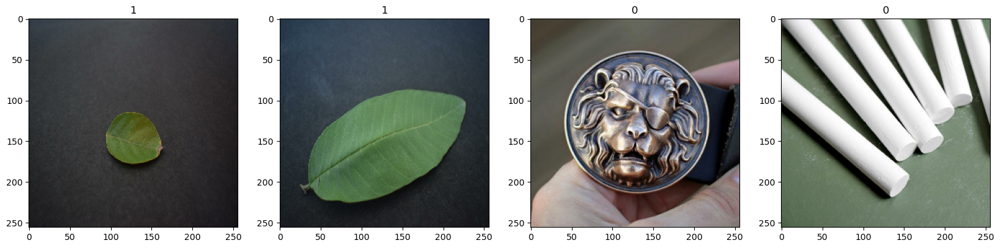

In [7]:
# plot the images in the batch, along with the labels
fig, ax = plt.subplots(ncols=4, figsize=(20,20))
for idx, img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

In [8]:
# normalize the pixel values of the images between 0 and 1 (from 0-255 to 0-1) 
data = data.map(lambda x,y: (x/255, y))

In [ ]:
# convert the data iterator to a NumPy iterator and fetch the next item
data.as_numpy_iterator().next()

In [ ]:
# split the data into train, validation and test sets (70%, 20%, 10%)
train_size = int(len(data)*.7)  + 1
val_size = int(len(data)*.2) + 1
test_size = int(len(data)*.1)  +1 

In [11]:
print(train_size)
print(val_size)
print(test_size)

289
83
42


In [12]:
# continue to split the data into train, validation and test sets
train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(train_size+val_size).take(test_size)

In [13]:
train

<TakeDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [14]:
from tensorflow.keras.models import Sequential

In [15]:
# create a sequential model because we are going to stack layers on top of each other sequentially
model = Sequential()

In [16]:
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout

In [17]:
# add the layers to the model one by one (convolutional, max pooling, dense, etc.) 
model.add(Conv2D(16, (3,3), 1, activation='relu', input_shape=(256,256,3)))
model.add(MaxPooling2D())
model.add(Conv2D(32, (3,3), 1, activation='relu'))
model.add(MaxPooling2D())
model.add(Conv2D(16, (3,3), 1, activation='relu'))
model.add(MaxPooling2D())
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

In [18]:
# compile the model with the optimizer, loss function and metrics
model.compile('adam', loss=tf.losses.BinaryCrossentropy(), metrics=['accuracy'])

In [19]:
# print the model summary
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 62, 62, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 16)        4624      
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 30, 30, 16)       0

In [22]:
# train the model with the train and validation sets and save the history of the training process
hist = model.fit(train, epochs=10, validation_data=val)

Epoch 1/10
289/289 [==============================] - 173s 592ms/step - loss: 0.2288 - accuracy: 0.9190 - val_loss: 0.1337 - val_accuracy: 0.9593
Epoch 2/10
289/289 [==============================] - 175s 601ms/step - loss: 0.1292 - accuracy: 0.9559 - val_loss: 0.1276 - val_accuracy: 0.9571
Epoch 3/10
289/289 [==============================] - 177s 607ms/step - loss: 0.1045 - accuracy: 0.9642 - val_loss: 0.1060 - val_accuracy: 0.9665
Epoch 4/10
289/289 [==============================] - 166s 569ms/step - loss: 0.0802 - accuracy: 0.9722 - val_loss: 0.1148 - val_accuracy: 0.9646
Epoch 5/10
289/289 [==============================] - 167s 572ms/step - loss: 0.0702 - accuracy: 0.9768 - val_loss: 0.1090 - val_accuracy: 0.9684
Epoch 6/10
289/289 [==============================] - 166s 569ms/step - loss: 0.0477 - accuracy: 0.9831 - val_loss: 0.1479 - val_accuracy: 0.9552
Epoch 7/10
289/289 [==============================] - 170s 582ms/step - loss: 0.0494 - accuracy: 0.9833 - val_loss: 0.0888 -

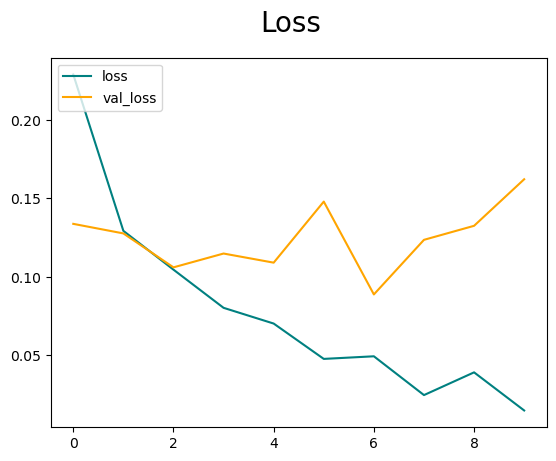

In [23]:
# plot the loss for the train and validation sets
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

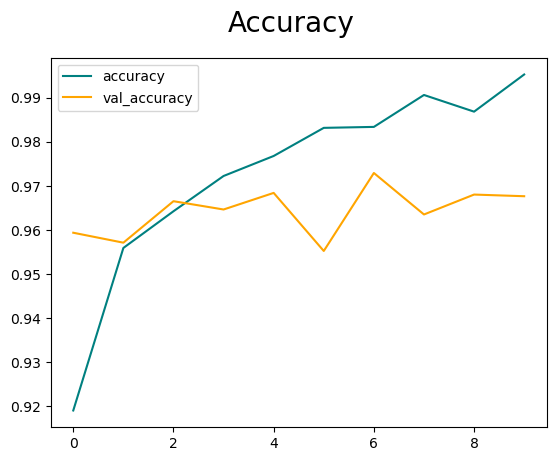

In [24]:
# plot the accuracy for the train and validation sets
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

In [25]:
from tensorflow.keras.metrics import Precision, Recall, BinaryAccuracy

In [26]:
# create precision, recall and accuracy metrics to evaluate the model on the test set
pre = Precision()
re = Recall()
acc = BinaryAccuracy()

In [27]:
# evaluate the model on the test set
for batch in test.as_numpy_iterator(): 
    X, y = batch
    yhat = model.predict(X)
    pre.update_state(y, yhat)
    re.update_state(y, yhat)
    acc.update_state(y, yhat)

1/1 [==============================] - 0s 145ms/step


In [28]:
# print the precision, recall and accuracy metrics for the test set
print(pre.result(), re.result(), acc.result())

tf.Tensor(0.95267177, shape=(), dtype=float32) tf.Tensor(0.9842271, shape=(), dtype=float32) tf.Tensor(0.9675376, shape=(), dtype=float32)


In [29]:
import cv2

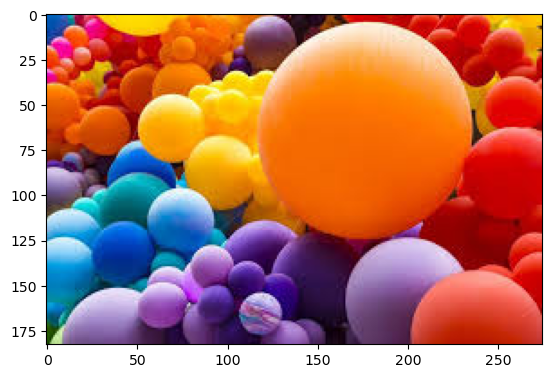

In [30]:
# read an image from the test set and plot it
img = cv2.imread(r"C:\Users\Safak\OneDrive\Masaüstü\anything_vs_leaves\DATASET_everything\images - 2023-05-09T233226.806.jpeg")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.show()

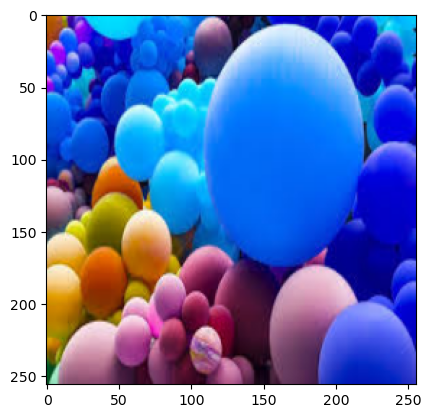

In [31]:
# resize the image to 256x256 and plot it
resize = tf.image.resize(img, (256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [33]:
import numpy as np

In [34]:
# predict the class of the image
yhat = model.predict(np.expand_dims(resize/255, 0))

1/1 [==============================] - 0s 18ms/step


In [35]:
yhat

array([[2.0857055e-08]], dtype=float32)

In [38]:
if yhat > 0.5: 
    print(f'Predicted class is ' + class_names[1])
else:
    print(f'Predicted class is ' + class_names[0])

Predicted class is DATASET_everything


In [50]:
from keras.preprocessing.image import ImageDataGenerator

In [51]:
# create an image data generator object
test_datagen = ImageDataGenerator(rescale = 1.0/255.)

In [53]:
# load the test set
test_generator = test_datagen.flow_from_directory(r"C:\Users\Safak\OneDrive\Masaüstü\test_leaf_vs_anything",  batch_size = 256, class_mode = 'binary', target_size = (256, 256))

Found 500 images belonging to 2 classes.


In [55]:
# evaluate the model on the test set one more time with evaluate method
model.evaluate(test_generator)

2/2 [==============================] - 25s 13s/step - loss: 0.0599 - accuracy: 0.9880


[0.059872452169656754, 0.9879999756813049]

In [39]:
# save the model
model_name = "anything_vs_leaf.h5"
model.save(model_name)

In [40]:
from tensorflow.keras.models import load_model
import keras

In [41]:
# load the model
my_model = keras.models.load_model("anything_vs_leaf.h5", compile = False)

In [42]:
import os

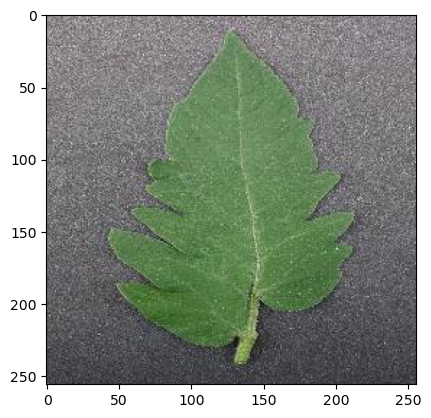

1/1 [==============================] - 0s 17ms/step
[[0.9999987]]
Predicted class is DATASET_leaf


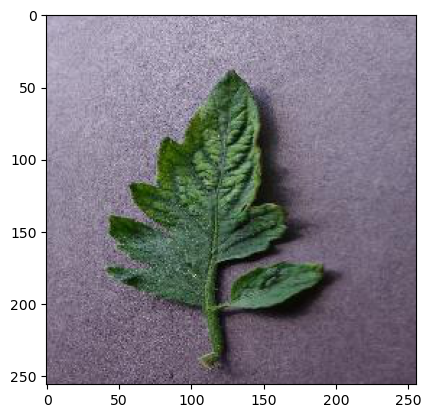

1/1 [==============================] - 0s 18ms/step
[[0.9996208]]
Predicted class is DATASET_leaf


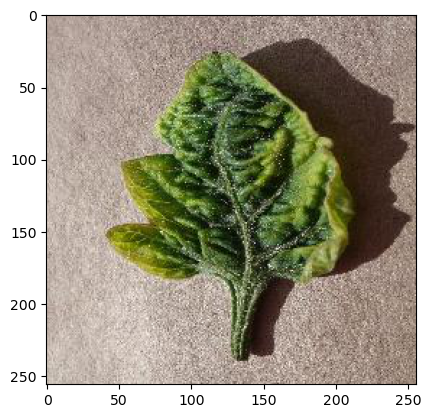

1/1 [==============================] - 0s 17ms/step
[[0.9834595]]
Predicted class is DATASET_leaf


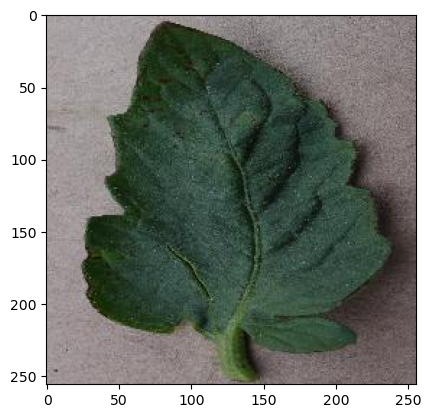

1/1 [==============================] - 0s 17ms/step
[[0.99999964]]
Predicted class is DATASET_leaf


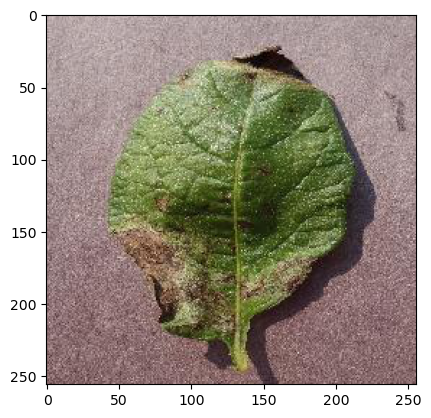

1/1 [==============================] - 0s 18ms/step
[[0.9996036]]
Predicted class is DATASET_leaf


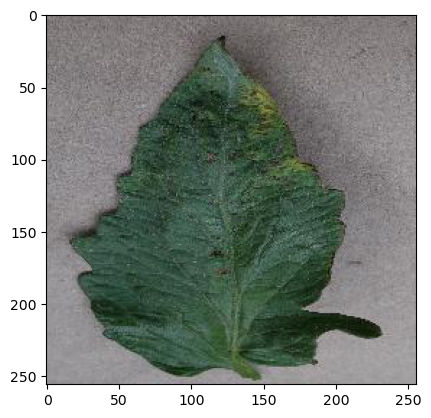

1/1 [==============================] - 0s 18ms/step
[[0.9999975]]
Predicted class is DATASET_leaf


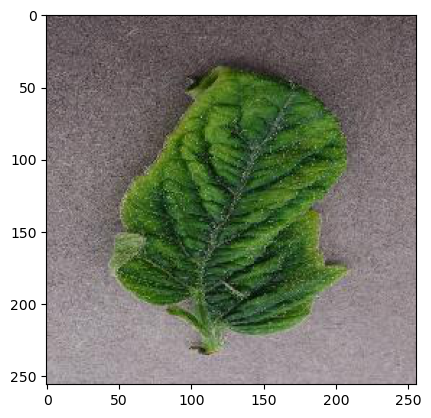

1/1 [==============================] - 0s 17ms/step
[[0.9999843]]
Predicted class is DATASET_leaf


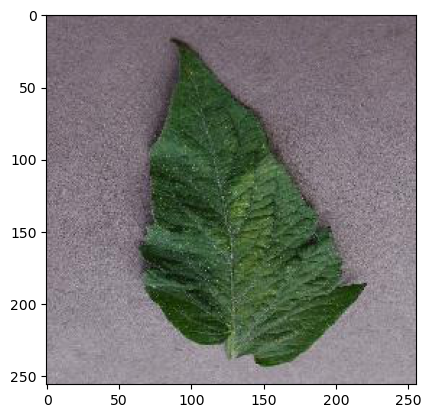

1/1 [==============================] - 0s 23ms/step
[[0.99473256]]
Predicted class is DATASET_leaf


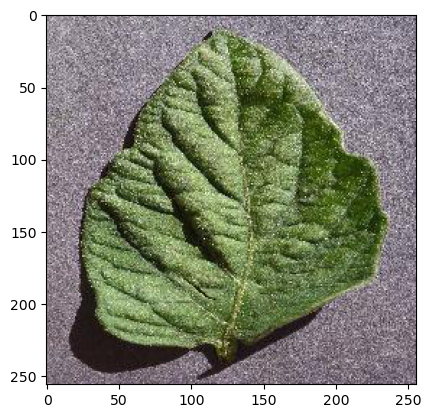

1/1 [==============================] - 0s 20ms/step
[[0.99999535]]
Predicted class is DATASET_leaf


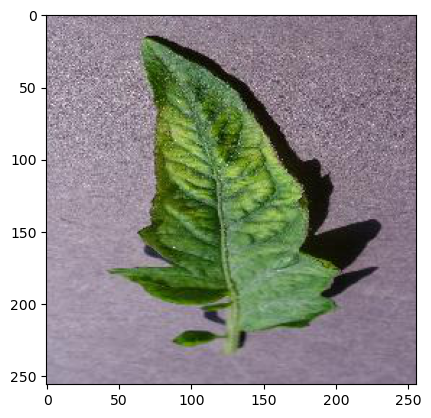

1/1 [==============================] - 0s 18ms/step
[[0.9996395]]
Predicted class is DATASET_leaf


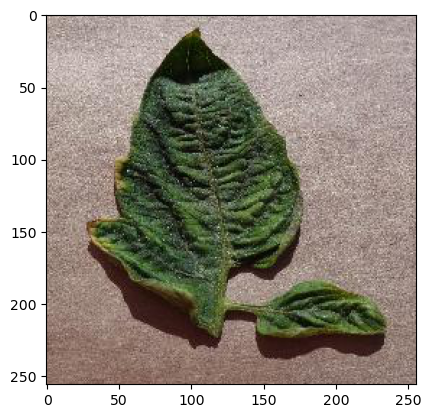

1/1 [==============================] - 0s 17ms/step
[[0.9940824]]
Predicted class is DATASET_leaf


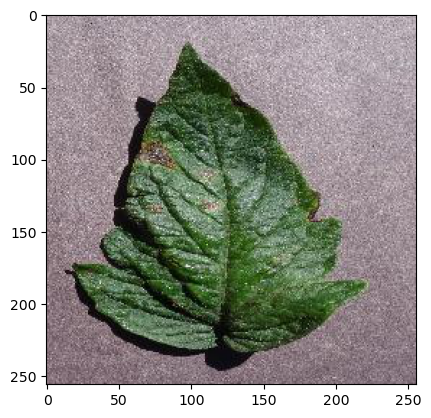

1/1 [==============================] - 0s 17ms/step
[[0.9999238]]
Predicted class is DATASET_leaf


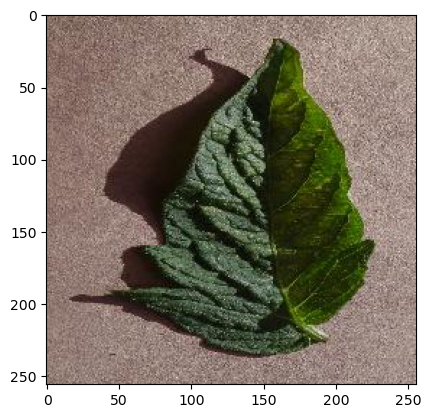

1/1 [==============================] - 0s 17ms/step
[[0.995769]]
Predicted class is DATASET_leaf


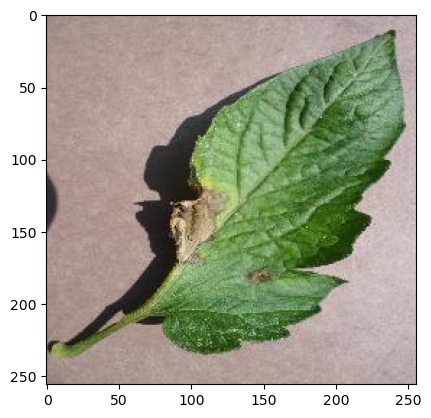

1/1 [==============================] - 0s 18ms/step
[[0.99997896]]
Predicted class is DATASET_leaf


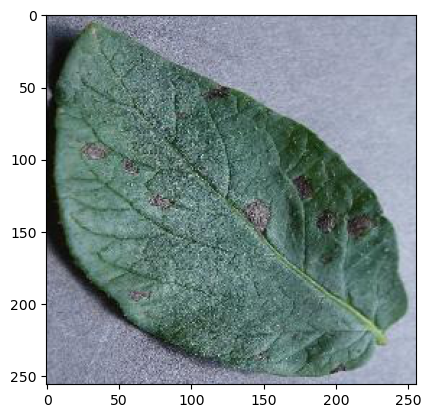

1/1 [==============================] - 0s 18ms/step
[[0.99875206]]
Predicted class is DATASET_leaf


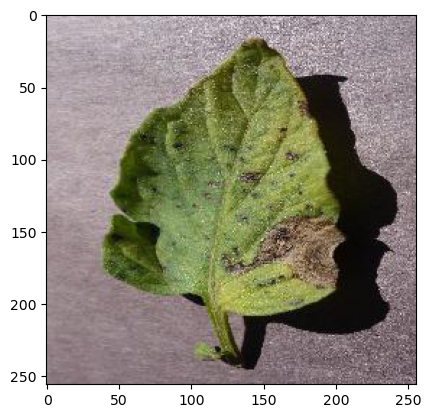

1/1 [==============================] - 0s 18ms/step
[[0.999392]]
Predicted class is DATASET_leaf


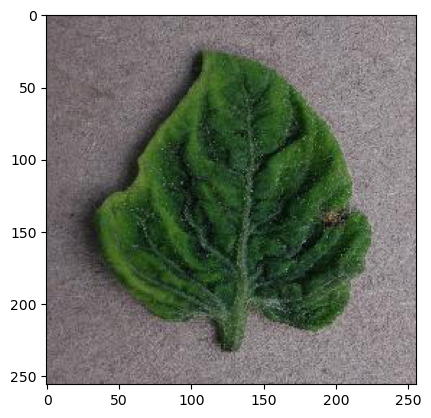

1/1 [==============================] - 0s 18ms/step
[[0.9999959]]
Predicted class is DATASET_leaf


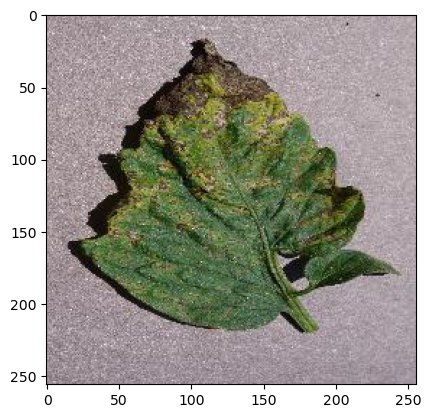

1/1 [==============================] - 0s 20ms/step
[[0.998661]]
Predicted class is DATASET_leaf


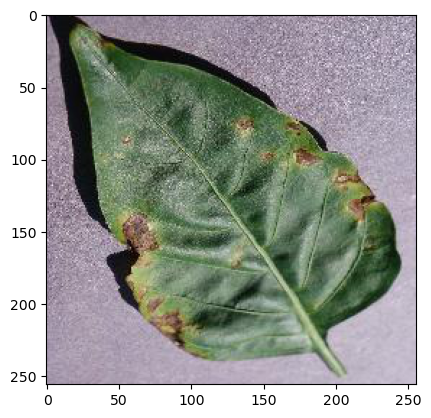

1/1 [==============================] - 0s 18ms/step
[[0.99997884]]
Predicted class is DATASET_leaf


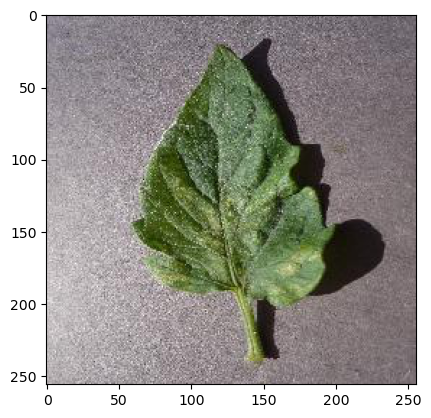

1/1 [==============================] - 0s 18ms/step
[[0.9998153]]
Predicted class is DATASET_leaf


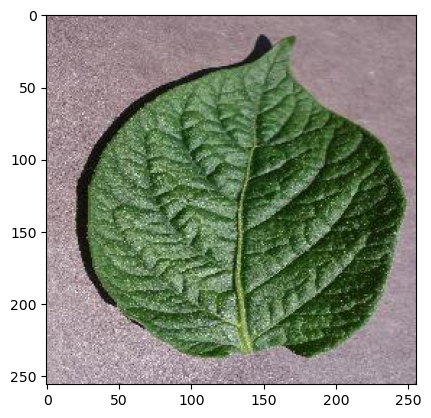

1/1 [==============================] - 0s 18ms/step
[[0.99996257]]
Predicted class is DATASET_leaf


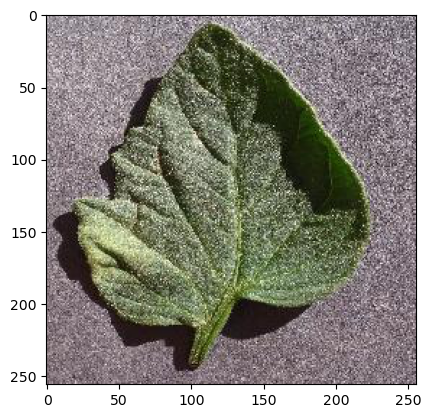

1/1 [==============================] - 0s 18ms/step
[[0.9972826]]
Predicted class is DATASET_leaf


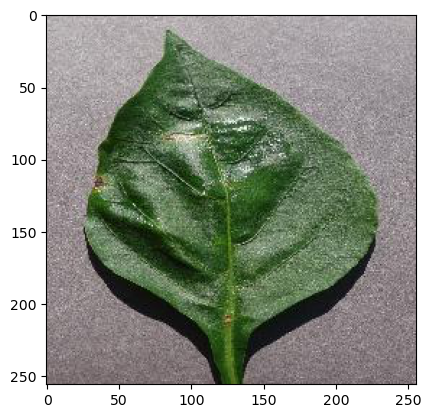

1/1 [==============================] - 0s 18ms/step
[[0.9999945]]
Predicted class is DATASET_leaf


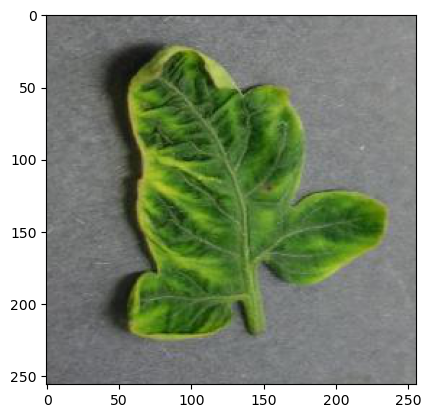

1/1 [==============================] - 0s 19ms/step
[[0.999968]]
Predicted class is DATASET_leaf


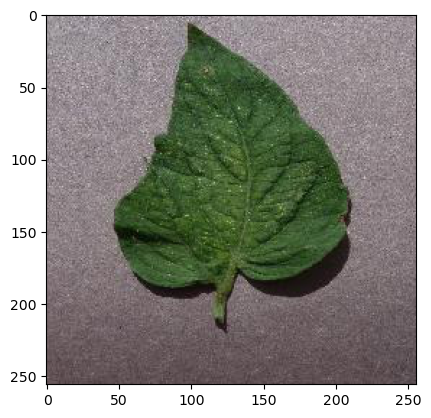

1/1 [==============================] - 0s 19ms/step
[[0.9999976]]
Predicted class is DATASET_leaf


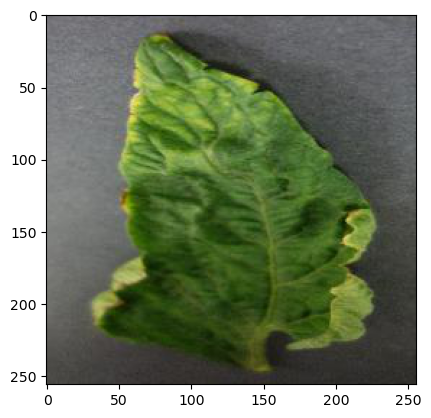

1/1 [==============================] - 0s 19ms/step
[[0.9997171]]
Predicted class is DATASET_leaf


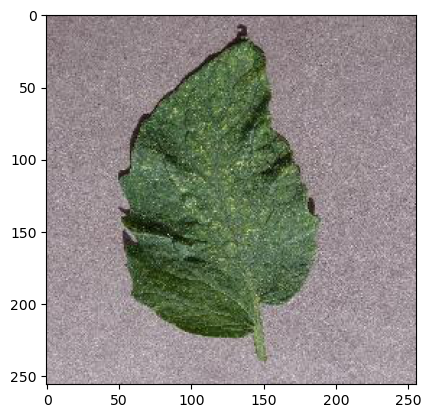

1/1 [==============================] - 0s 20ms/step
[[0.99988294]]
Predicted class is DATASET_leaf


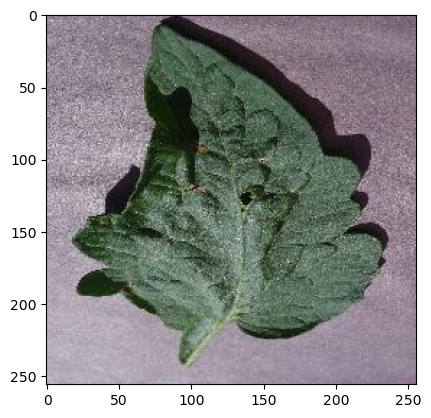

1/1 [==============================] - 0s 19ms/step
[[0.9999999]]
Predicted class is DATASET_leaf


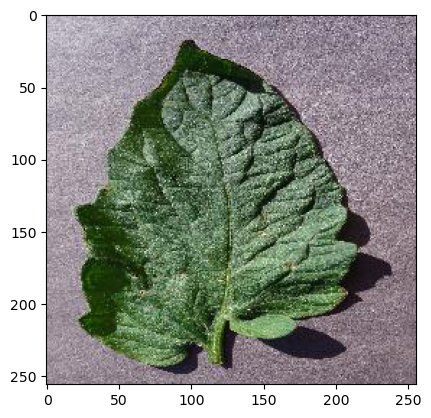

1/1 [==============================] - 0s 18ms/step
[[0.99998367]]
Predicted class is DATASET_leaf


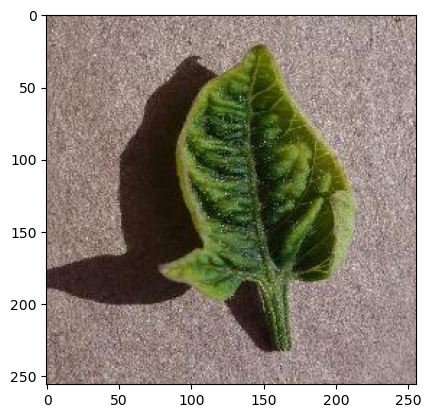

1/1 [==============================] - 0s 17ms/step
[[0.9999982]]
Predicted class is DATASET_leaf


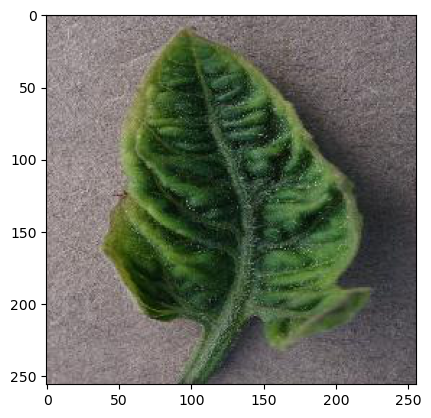

1/1 [==============================] - 0s 18ms/step
[[0.99997944]]
Predicted class is DATASET_leaf


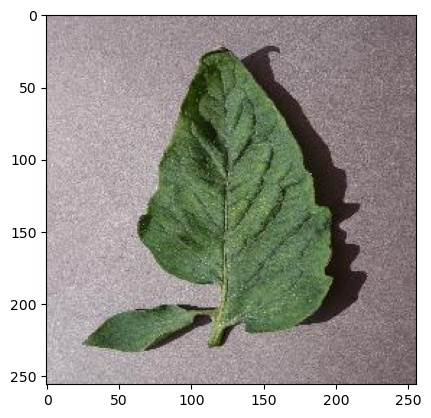

1/1 [==============================] - 0s 19ms/step
[[0.9999988]]
Predicted class is DATASET_leaf


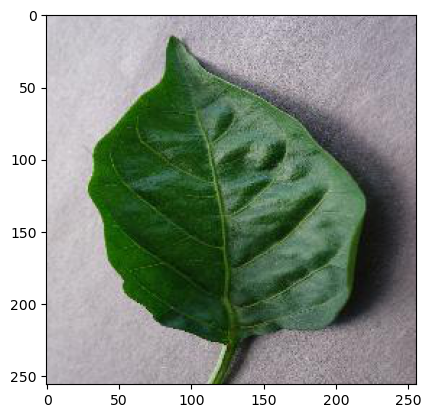

1/1 [==============================] - 0s 20ms/step
[[0.9999999]]
Predicted class is DATASET_leaf


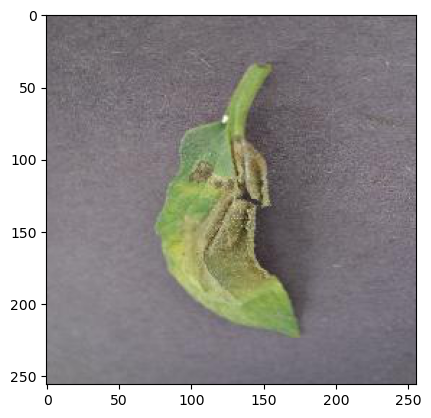

1/1 [==============================] - 0s 18ms/step
[[0.9794438]]
Predicted class is DATASET_leaf


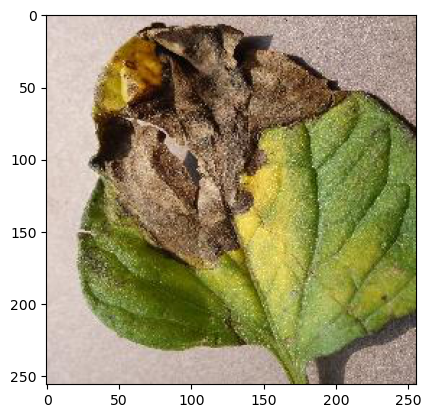

1/1 [==============================] - 0s 18ms/step
[[0.05079675]]
Predicted class is DATASET_everything


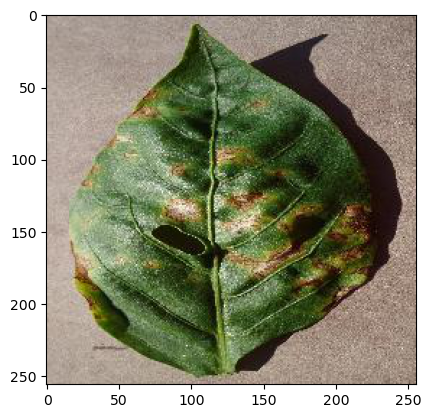

1/1 [==============================] - 0s 18ms/step
[[0.9999618]]
Predicted class is DATASET_leaf


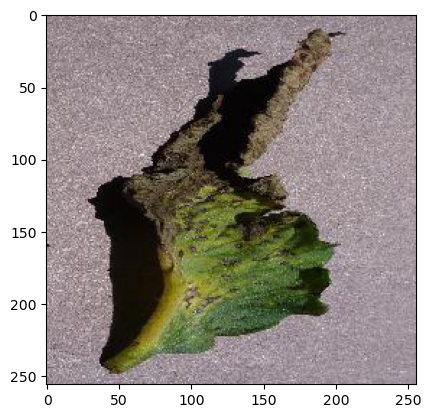

1/1 [==============================] - 0s 17ms/step
[[0.02006877]]
Predicted class is DATASET_everything


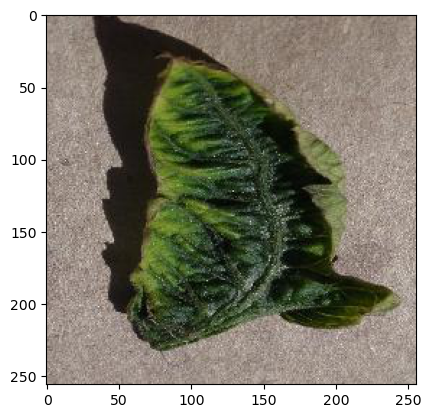

1/1 [==============================] - 0s 17ms/step
[[0.99975836]]
Predicted class is DATASET_leaf


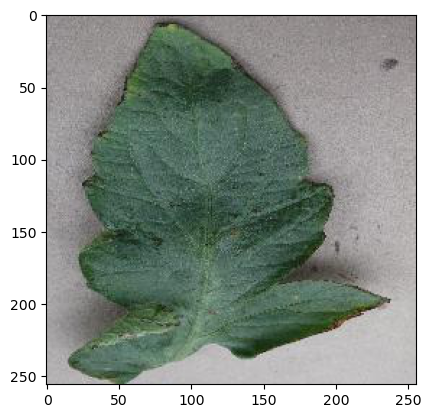

1/1 [==============================] - 0s 19ms/step
[[0.99993587]]
Predicted class is DATASET_leaf


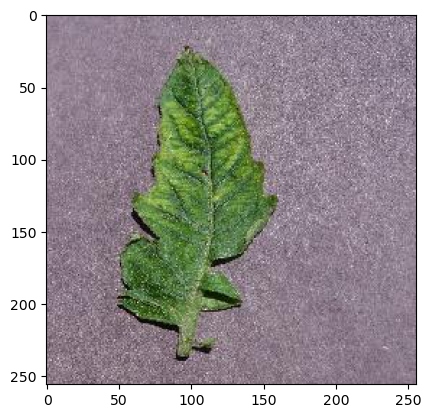

1/1 [==============================] - 0s 17ms/step
[[0.99012583]]
Predicted class is DATASET_leaf


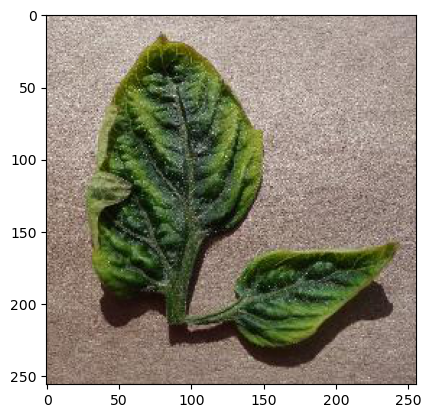

1/1 [==============================] - 0s 19ms/step
[[0.99034023]]
Predicted class is DATASET_leaf


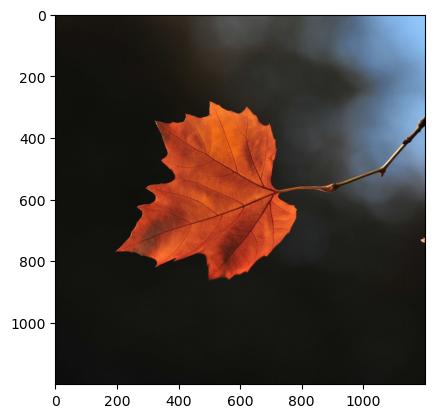

1/1 [==============================] - 0s 18ms/step
[[2.609561e-09]]
Predicted class is DATASET_everything


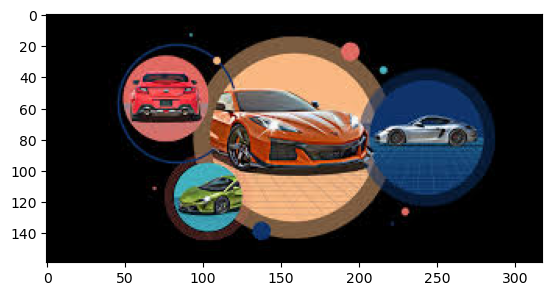

1/1 [==============================] - 0s 18ms/step
[[1.815217e-05]]
Predicted class is DATASET_everything


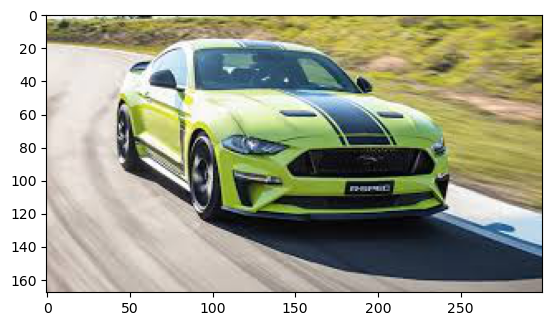

1/1 [==============================] - 0s 18ms/step
[[0.88203526]]
Predicted class is DATASET_leaf


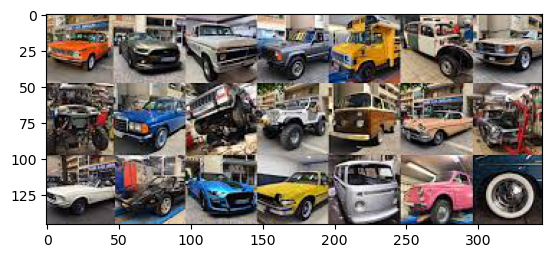

1/1 [==============================] - 0s 18ms/step
[[2.7335618e-08]]
Predicted class is DATASET_everything


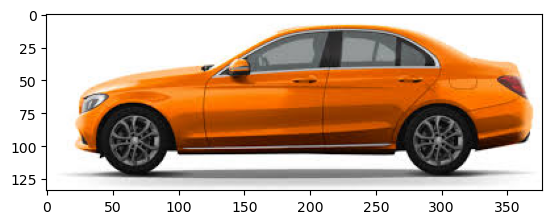

1/1 [==============================] - 0s 18ms/step
[[3.5481512e-10]]
Predicted class is DATASET_everything


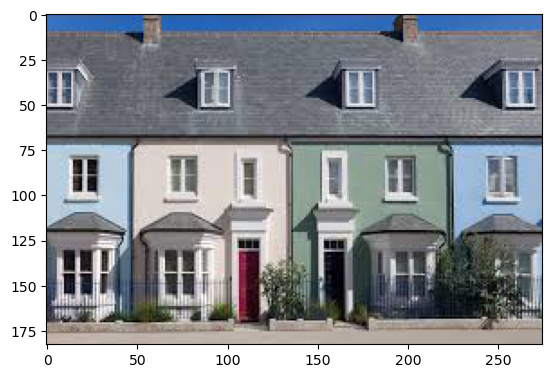

1/1 [==============================] - 0s 19ms/step
[[0.00011425]]
Predicted class is DATASET_everything


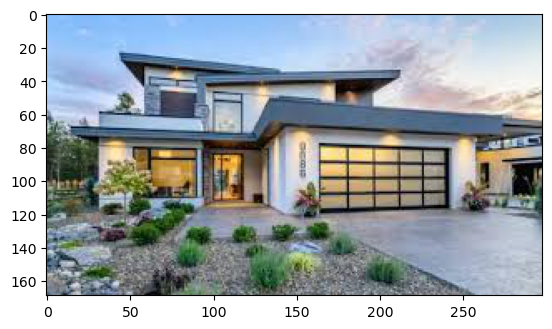

1/1 [==============================] - 0s 17ms/step
[[1.910672e-08]]
Predicted class is DATASET_everything


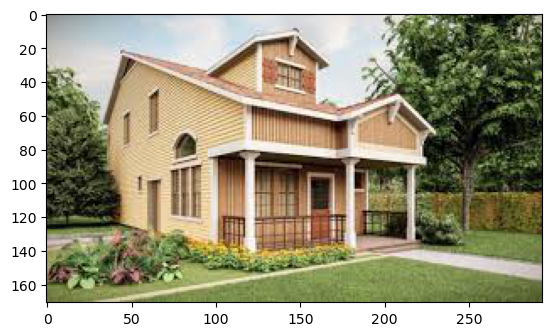

1/1 [==============================] - 0s 18ms/step
[[2.4930378e-05]]
Predicted class is DATASET_everything


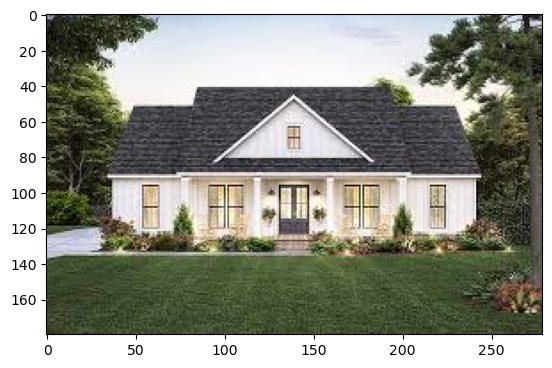

1/1 [==============================] - 0s 17ms/step
[[1.1218124e-09]]
Predicted class is DATASET_everything


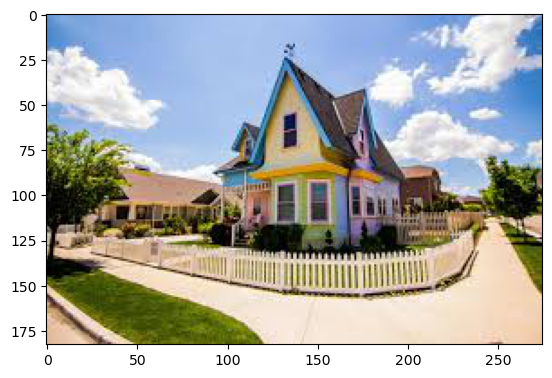

1/1 [==============================] - 0s 18ms/step
[[1.5746456e-06]]
Predicted class is DATASET_everything


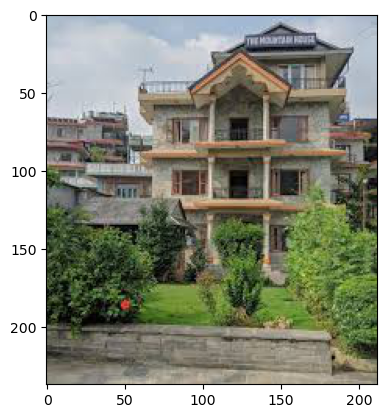

1/1 [==============================] - 0s 18ms/step
[[0.00145153]]
Predicted class is DATASET_everything


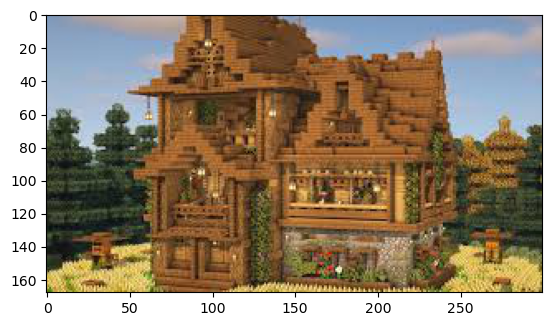

1/1 [==============================] - 0s 18ms/step
[[3.481765e-05]]
Predicted class is DATASET_everything


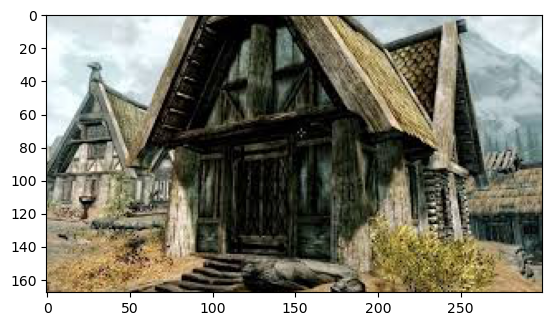

1/1 [==============================] - 0s 17ms/step
[[0.03411182]]
Predicted class is DATASET_everything


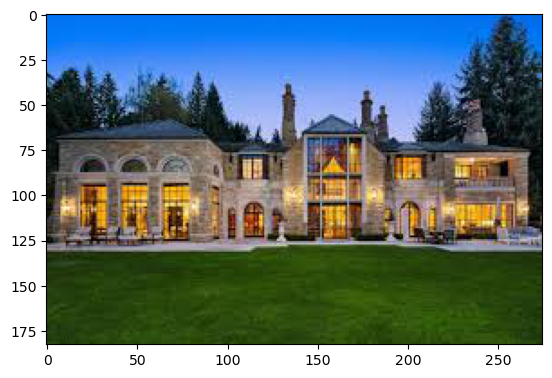

1/1 [==============================] - 0s 16ms/step
[[0.00017299]]
Predicted class is DATASET_everything


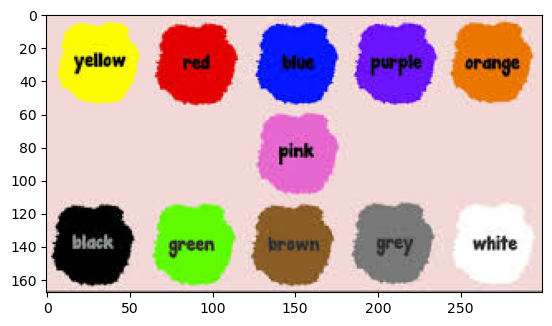

1/1 [==============================] - 0s 18ms/step
[[0.49728748]]
Predicted class is DATASET_everything


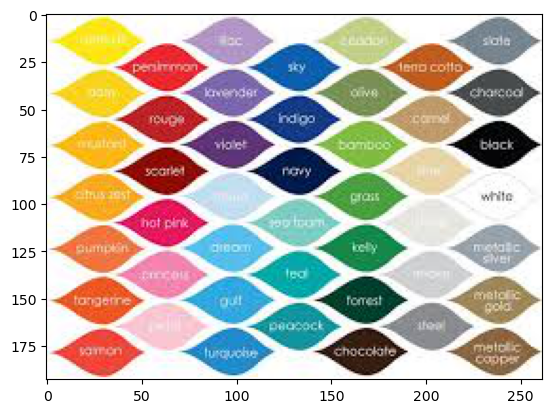

1/1 [==============================] - 0s 18ms/step
[[0.90115523]]
Predicted class is DATASET_leaf


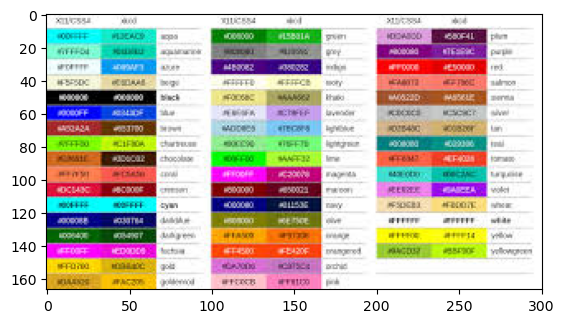

1/1 [==============================] - 0s 17ms/step
[[0.4274202]]
Predicted class is DATASET_everything


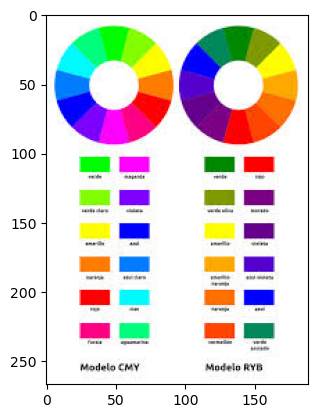

1/1 [==============================] - 0s 17ms/step
[[9.358842e-05]]
Predicted class is DATASET_everything


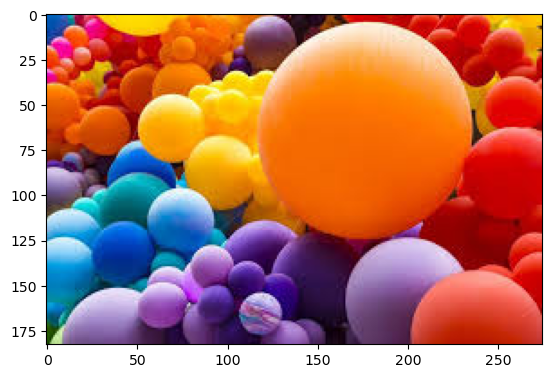

1/1 [==============================] - 0s 17ms/step
[[2.0857055e-08]]
Predicted class is DATASET_everything


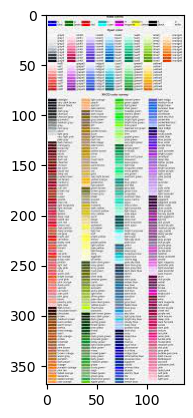

1/1 [==============================] - 0s 18ms/step
[[0.3035687]]
Predicted class is DATASET_everything


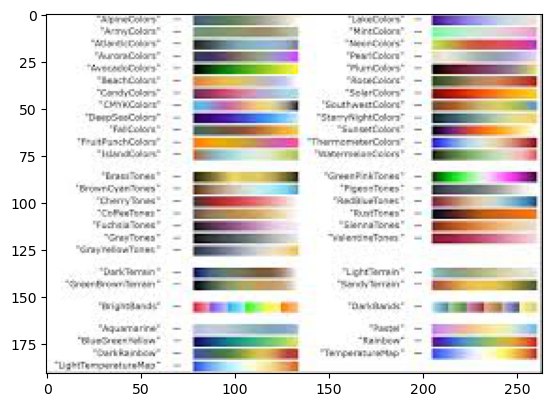

1/1 [==============================] - 0s 19ms/step
[[4.413902e-07]]
Predicted class is DATASET_everything


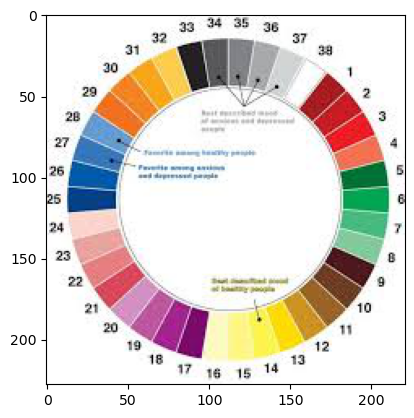

1/1 [==============================] - 0s 18ms/step
[[3.5974142e-06]]
Predicted class is DATASET_everything


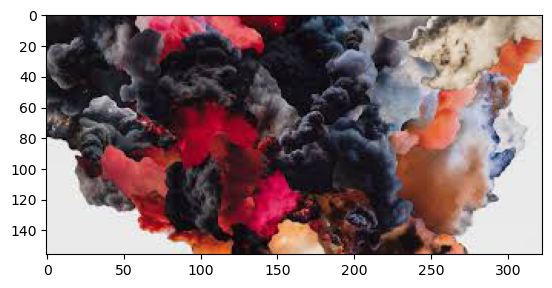

1/1 [==============================] - 0s 17ms/step
[[1.7511975e-05]]
Predicted class is DATASET_everything


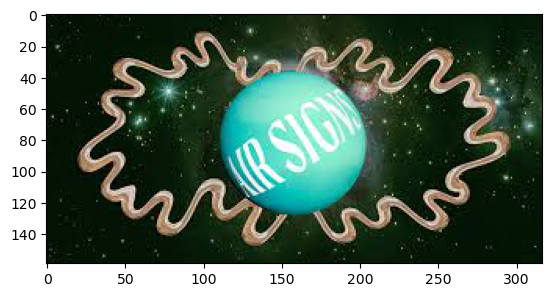

1/1 [==============================] - 0s 18ms/step
[[0.99993783]]
Predicted class is DATASET_leaf


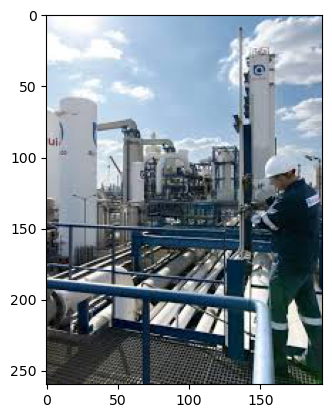

1/1 [==============================] - 0s 19ms/step
[[3.7841674e-11]]
Predicted class is DATASET_everything


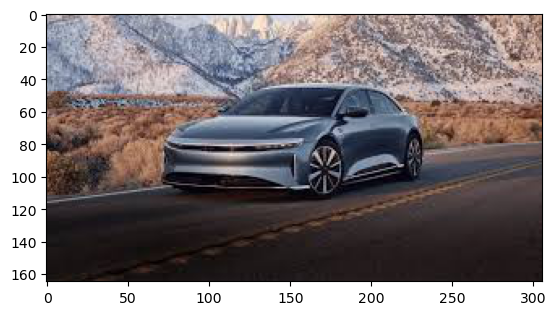

1/1 [==============================] - 0s 19ms/step
[[4.1695165e-07]]
Predicted class is DATASET_everything


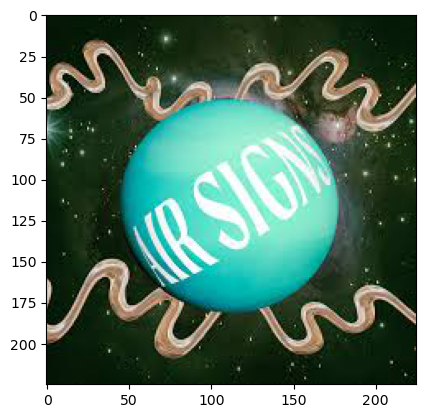

1/1 [==============================] - 0s 16ms/step
[[0.9999993]]
Predicted class is DATASET_leaf


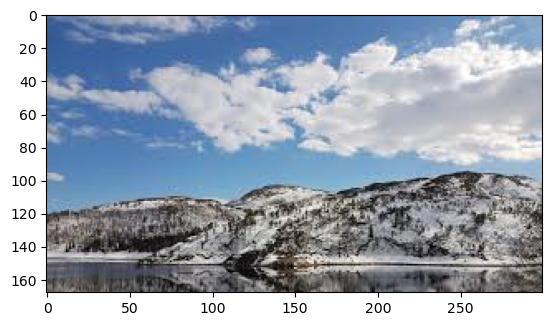

1/1 [==============================] - 0s 18ms/step
[[6.8634354e-06]]
Predicted class is DATASET_everything


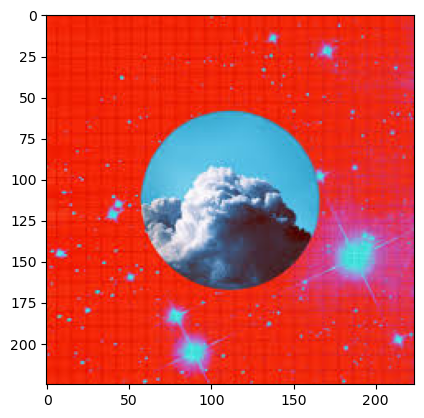

1/1 [==============================] - 0s 20ms/step
[[0.08752552]]
Predicted class is DATASET_everything


In [44]:
# iterate over the images in the test set and predict the class of each image
dir_path = r"C:\Users\Safak\OneDrive\Masaüstü\test_leaf_vs_anything"
    
for filename in os.listdir(dir_path):
    if filename.endswith(".jpg") or filename.endswith(".PNG") or filename.endswith(".png") or filename.endswith(".jpeg") or filename.endswith(".JPG") or filename.endswith(".JPEG"):
        img_name = filename
        img_name = dir_path +'//'+ img_name
        img = cv2.imread(img_name)
        
        resize = tf.image.resize(img, (256,256))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.show()
        yhat_new = my_model.predict(np.expand_dims(resize/255, 0))
        print(yhat_new)
        if yhat_new > 0.5: 
            print(f'Predicted class is ' + class_names[1])
            """
            GO AHEAD!
            """
        else:
            print(f'Predicted class is ' + class_names[0])
            """
            TRY AGAIN!
            """

In [45]:
# load the h5 model
model = tf.keras.models.load_model('anything_vs_leaf.h5')

# convert the model to tflite format to use in flutter
tf.saved_model.save(model, 'anything_vs_leaf.tflite')

INFO:tensorflow:Assets written to: leaf_vs_anything_6th_trial.tflite\assets


INFO:tensorflow:Assets written to: leaf_vs_anything_6th_trial.tflite\assets
